PROYECTO


1. IMPORTACIONES


In [1]:
#Debo importar todas las librerias ya descargadas en el programa
### IMPORTACIONES QUE YA TENIA INSTALADAS
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
## ALGORITMOS PARA MODELADO
from sklearn.linear_model import LinearRegression, LogisticRegression 
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.preprocessing import LabelEncoder,StandardScaler, OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score 
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from IPython.display import display
from scipy.stats import skew, kurtosis
from sklearn.impute import KNNImputer

###NOTAS
# pandas, numpy → Manejo y manipulación de datos.
# seaborn, matplotlib → Visualización de datos.
# sklearn.linear_model → Modelos de regresión (lineal y logística).
# sklearn.ensemble → Modelos de bosque aleatorio.
# sklearn.tree → Árboles de decisión (regresión y clasificación).
# sklearn.model_selection → División de datos y validación cruzada.
# sklearn.preprocessing → Escalado y codificación de variables.
# sklearn.metrics → Evaluación de modelos.
# sklearn.impute → Manejo de valores nulos.
# sklearn.pipeline → Creación de flujos de preprocesamiento y modelado.


1.2 CARGA DATASET

In [2]:
# Carga del archivo, separando por COMAS la información
proyecto = pd.read_csv("madrid_dataset_idealista.csv", delimiter=",")
# Visualización archivo 
print(proyecto.head())


     web_id                                              url  \
0  99439319  https://www.idealista.com/en/inmueble/99439319/   
1  99439586  https://www.idealista.com/en/inmueble/99439586/   
2  99439169  https://www.idealista.com/en/inmueble/99439169/   
3  26925909  https://www.idealista.com/en/inmueble/26925909/   
4  99440018  https://www.idealista.com/en/inmueble/99440018/   

                                               title       type  price  \
0         Flat / apartment for rent in pablo luna, 4       Flat   1400   
1             Penthouse for rent in calle de Bolivia  Penthouse   1300   
2          Duplex for rent in calle de la constancia     Duplex    950   
3  Flat / apartment for rent in Urb. el viso, El ...       Flat   2975   
4               Studio flat for rent in luis cabrera     Studio    650   

   deposit  private_owner     professional_name  floor_built  floor_area  ...  \
0      NaN          False  Silcasas Ochocientas           60         NaN  ...   
1      1

1.3 INFORMACIÓN

In [3]:
proyecto.describe()
display(proyecto.head(10))  # Muestra las primeras 10 filas
print("Tamaño archivo ", proyecto.shape)
print("Tipos",proyecto.dtypes)


,web_id,url,title,type,price,deposit,private_owner,professional_name,floor_built,floor_area,...,terrace,balcony,storeroom,swimming_pool,garden_area,location,district,subdistrict,postalcode,last_update
0,99439319,https://www.idealista.com/en/inmueble/99439319/,"Flat / apartment for rent in pablo luna, 4",Flat,1400,NaN,False,Silcasas Ochocientas,60,NaN,...,True,False,False,False,False,"pablo luna, 4, Subdistrict Castilla, District ...",Chamartín,Castilla,28046.0,7 November
1,99439586,https://www.idealista.com/en/inmueble/99439586/,Penthouse for rent in calle de Bolivia,Penthouse,1300,1.0,False,Cruzity,77,NaN,...,False,False,False,False,False,"Calle de Bolivia, Subdistrict Bernabéu-Hispano...",Chamartín,Bernabéu-Hispanoamérica,28016.0,7 November
2,99439169,https://www.idealista.com/en/inmueble/99439169/,Duplex for rent in calle de la constancia,Duplex,950,1.0,False,Mm Home,72,68.0,...,True,False,False,False,False,"Calle de la constancia, Urb. no, Subdistrict P...",Chamartín,Prosperidad,28002.0,7 November
3,26925909,https://www.idealista.com/en/inmueble/26925909/,"Flat / apartment for rent in Urb. el viso, El ...",Flat,2975,1.0,False,B&H Partners,160,NaN,...,True,False,False,True,False,"Urb. el viso, Subdistrict El Viso, District Ch...",Chamartín,El Viso,NaN,7 November
4,99440018,https://www.idealista.com/en/inmueble/99440018/,Studio flat for rent in luis cabrera,Studio,650,1.0,False,Madrid en Propiedad,30,NaN,...,False,True,False,False,False,"luis cabrera, Subdistrict Prosperidad, Distric...",Chamartín,Prosperidad,28002.0,7 November
5,99440142,https://www.idealista.com/en/inmueble/99440142/,Flat / apartment for rent in calle de Nieremberg,Flat,1200,NaN,False,Extra Inmobiliaria,54,47.0,...,False,False,True,True,False,"Calle de Nieremberg, Subdistrict Ciudad Jardín...",Chamartín,Ciudad Jardín,28002.0,7 November
6,97624351,https://www.idealista.com/en/inmueble/97624351/,"Flat / apartment for rent in calle de vinaroz, 26",Flat,1290,1.0,False,Youhomey,55,50.0,...,True,False,False,False,False,"Calle de vinaroz, 26, Subdistrict Ciudad Jardí...",Chamartín,Ciudad Jardín,28002.0,7 November
7,99440148,https://www.idealista.com/en/inmueble/99440148/,Flat / apartment for rent in calle de Ramos Ca...,Flat,900,1.0,False,TECNOCASA PROSPERIDAD,35,NaN,...,False,False,False,False,False,"Calle de Ramos Carrión, 4, Subdistrict Prosper...",Chamartín,Prosperidad,28002.0,7 November
8,84678272,https://www.idealista.com/en/inmueble/84678272/,Terraced house for rent in calle de la Madre ...,Terraced,3895,NaN,False,Ivory Homes,141,140.0,...,True,False,False,False,False,"Calle de la Madre de Dios, Madrid, Subdistrict...",Chamartín,Nueva España,28016.0,7 November
9,99440827,https://www.idealista.com/en/inmueble/99440827/,Flat / apartment for rent in calle de Pastora ...,Flat,1750,NaN,False,PUBLICASA MADRID,148,NaN,...,True,False,False,True,False,"Calle de Pastora Imperio, Subdistrict Castilla...",Chamartín,Castilla,28036.0,7 November


Tamaño archivo  (9229, 32)
Tipos web_id                 int64
url                   object
title                 object
type                  object
price                  int64
deposit              float64
private_owner           bool
professional_name     object
floor_built            int64
floor_area           float64
floor                 object
year_built           float64
orientation           object
bedrooms               int64
bathrooms              int64
second_hand             bool
lift                    bool
garage_included         bool
furnished               bool
equipped_kitchen        bool
fitted_wardrobes        bool
air_conditioning        bool
terrace                 bool
balcony                 bool
storeroom               bool
swimming_pool           bool
garden_area             bool
location              object
district              object
subdistrict           object
postalcode           float64
last_update           object
dtype: object


1.4 LIMPIEZA DE DATOS

1.4.1 Transformación de los datos

In [4]:
#INFORMACIÓN BÁSICA
print("Tamaño archivo ", proyecto.shape)
print("Tipos",proyecto.dtypes)

Tamaño archivo  (9229, 32)
Tipos web_id                 int64
url                   object
title                 object
type                  object
price                  int64
deposit              float64
private_owner           bool
professional_name     object
floor_built            int64
floor_area           float64
floor                 object
year_built           float64
orientation           object
bedrooms               int64
bathrooms              int64
second_hand             bool
lift                    bool
garage_included         bool
furnished               bool
equipped_kitchen        bool
fitted_wardrobes        bool
air_conditioning        bool
terrace                 bool
balcony                 bool
storeroom               bool
swimming_pool           bool
garden_area             bool
location              object
district              object
subdistrict           object
postalcode           float64
last_update           object
dtype: object


Transformación de datos:
- Las columnas binarias deben ser numeros enteros
- Las columnas categóricas deben ser category
- La columna FLOOR debe ser numérica
- La columna año, no puede presentar decimales
- La columna CP, no puede presentar decimales
- Formato fecha

In [5]:
# Encontrar columnas BINARIAS
binarias = binary_columns = proyecto.select_dtypes(include=["bool"]).columns.tolist()
print("Variables binarias encontradas:", binarias)

# Convertir variables binarias de booleano a entero (0 y 1)

proyecto[binarias] = proyecto[binarias].astype(np.int64)

# Verificación
print(proyecto[binarias].dtypes)


Variables binarias encontradas: ['private_owner', 'second_hand', 'lift', 'garage_included', 'furnished', 'equipped_kitchen', 'fitted_wardrobes', 'air_conditioning', 'terrace', 'balcony', 'storeroom', 'swimming_pool', 'garden_area']
private_owner       int64
second_hand         int64
lift                int64
garage_included     int64
furnished           int64
equipped_kitchen    int64
fitted_wardrobes    int64
air_conditioning    int64
terrace             int64
balcony             int64
storeroom           int64
swimming_pool       int64
garden_area         int64
dtype: object


In [6]:

# Encontrar columnas CATEGORICAS
categoricas = proyecto.select_dtypes(include=['object']).columns.tolist()
print("Variables categóricas encontradas:", categoricas)

# Convertir columnas category en categóricas
for col in categoricas:
    proyecto[col] = proyecto[col].astype("category")

# Verificación
print(proyecto[categoricas].dtypes)

Variables categóricas encontradas: ['url', 'title', 'type', 'professional_name', 'floor', 'orientation', 'location', 'district', 'subdistrict', 'last_update']
url                  category
title                category
type                 category
professional_name    category
floor                category
orientation          category
location             category
district             category
subdistrict          category
last_update          category
dtype: object


In [7]:
#FLOOR TRANSFORMACIÓN
proyecto["floor"] = pd.to_numeric(proyecto["floor"], errors="coerce")  # Convierte a número
proyecto["floor"] = proyecto["floor"].fillna(0)  # Reemplaza NaN con 0
#Comprobación FLOOR
print("FLOOR tipo:",proyecto["floor"].dtype)

#YEAR BUILT TRANSFORMARCION
proyecto["year_built"] = proyecto["year_built"].fillna(0).astype(np.int64) # Convierte a número
#Comprobación YEAR
print("AÑO tipo:",proyecto["year_built"].dtype)

#CP TRANSFORMACIÓN
proyecto["postalcode"] = proyecto["postalcode"].fillna(0).astype(np.int64)
#Comprobación CP
print("CP tipo:",proyecto["year_built"].dtype)

# LAST UPDATE TRANSFORMACIÓN (Último post)
proyecto["last_update"] = pd.to_datetime(proyecto["last_update"], format="%d %B %Y", errors="coerce")

#Comprobación LAST UPDATE
print("LAST UPDATE tipo:",proyecto["last_update"].dtype)

FLOOR tipo: float64
AÑO tipo: int64
CP tipo: int64
LAST UPDATE tipo: datetime64[ns]


In [8]:
#COMPOROBACIÓN
print("Tamaño archivo ", proyecto.shape)
print("Tipos",proyecto.dtypes)

Tamaño archivo  (9229, 32)
Tipos web_id                        int64
url                        category
title                      category
type                       category
price                         int64
deposit                     float64
private_owner                 int64
professional_name          category
floor_built                   int64
floor_area                  float64
floor                       float64
year_built                    int64
orientation                category
bedrooms                      int64
bathrooms                     int64
second_hand                   int64
lift                          int64
garage_included               int64
furnished                     int64
equipped_kitchen              int64
fitted_wardrobes              int64
air_conditioning              int64
terrace                       int64
balcony                       int64
storeroom                     int64
swimming_pool                 int64
garden_area                   i

1.4.2 Nulos y duplicados

In [9]:
#ELIMINAR DUPLICADOS
proyecto = proyecto.drop_duplicates()
proyecto.shape

(9229, 32)

In [10]:
# NULOS
#Comprobación de cantidad de columnas con datos nulos
print(proyecto.isnull().sum()[proyecto.isnull().sum() > 0])
# Cantidad de nulos
print("\nValores nulos por columna:", proyecto.isnull().sum())

deposit              3822
professional_name    1607
floor_area           5291
orientation          4818
district              133
subdistrict           771
last_update          9229
dtype: int64

Valores nulos por columna: web_id                  0
url                     0
title                   0
type                    0
price                   0
deposit              3822
private_owner           0
professional_name    1607
floor_built             0
floor_area           5291
floor                   0
year_built              0
orientation          4818
bedrooms                0
bathrooms               0
second_hand             0
lift                    0
garage_included         0
furnished               0
equipped_kitchen        0
fitted_wardrobes        0
air_conditioning        0
terrace                 0
balcony                 0
storeroom               0
swimming_pool           0
garden_area             0
location                0
district              133
subdistrict           7

Se revisaran uno por uno las filas con valores nulos y se actuara sobre ellos

In [11]:
#PROFESSIONAL NAME
# Ver cuántos valores nulos hay antes de reemplazar:
print(proyecto["professional_name"].isnull().sum())  

# Sustituir valores nulos (NaN) por "Particular": 
proyecto["professional_name"] = proyecto["professional_name"].astype(str).fillna("Particular")

# Comprobación:
print(proyecto["professional_name"].isnull().sum())  

1607
0


In [12]:
#FLOOR AREA
# Ver cuántos valores nulos hay antes de reemplazar:
print(proyecto["floor_area"].isnull().sum())  
# Sustituir valores nulos (NaN) por "0" ya que ouede ser un bajo 
proyecto["floor_area"] = proyecto["floor_area"].fillna(0)  # Sustituir NaN por 0
# Comprobación
print(proyecto["floor_area"].isnull().sum())  


5291
0


In [13]:
#DEPOSITO
# Ver cuántos valores nulos hay antes de reemplazar:
print(proyecto["deposit"].isnull().sum())  
 
# Sustituir valores nulos (NaN) por 0 ya que puede ser que no se exija
proyecto["deposit"] = proyecto["deposit"].fillna(0)

# Comprobación
print(proyecto["deposit"].isnull().sum())

3822
0


In [14]:
#DISTRICIT
proyecto["district"] = proyecto.groupby("postalcode")["district"].transform(lambda x: x.fillna(x.mode()[0]) if not x.mode().empty else "Desconocido")
proyecto["subdistrict"] = proyecto.groupby("postalcode")["subdistrict"].transform(lambda x: x.fillna(x.mode()[0]) if not x.mode().empty else "Desconocido")
#Comprobación
print(proyecto.isnull().sum()[proyecto.isnull().sum() > 0])

orientation    4818
last_update    9229
dtype: int64


In [15]:
#ORIENTATION
print(proyecto["orientation"].unique()) 
#La info hace referencia a las 4 orientaciones, voy a transformar nan por desconocido
proyecto["orientation"] = proyecto["orientation"].cat.add_categories("Desconocido")
proyecto["orientation"] = proyecto["orientation"].fillna("Desconocido")
print(proyecto["orientation"].unique()) 

[NaN, 'east', 'west', 'north', 'south']
Categories (4, object): ['east', 'north', 'south', 'west']
['Desconocido', 'east', 'west', 'north', 'south']
Categories (5, object): ['east', 'north', 'south', 'west', 'Desconocido']


In [16]:
# YEAR BULILT: Reemplazar por la mediana
proyecto['year_built'] = proyecto['year_built'].replace(0, proyecto['year_built'][proyecto['year_built'] > 0].median())

In [17]:
#POSTALCODE: Cambio de los valores 0 por la moda

moda_postal = proyecto.loc[proyecto['postalcode'] > 0, 'postalcode'].mode()[0]
proyecto['postalcode'] = proyecto['postalcode'].replace(0, moda_postal)

1.4.2 Eliminación de columnas

In [18]:
# Eliminar WEB_ID y url: no aporta
proyecto.drop(columns=['web_id', 'url', 'last_update'], inplace=True)


In [19]:
nulos = proyecto.isnull().sum()
nulos = nulos[nulos > 0]  # Filtrar solo las que tienen nulos
print(nulos)

Series([], dtype: int64)


1.4.3 Escalado para normalizar los datos

In [20]:
# Definir el escalador
scaler = StandardScaler()
num_cols = proyecto.select_dtypes(include=['int64', 'float64']).columns.tolist()
# Aplicar escalado a variables numéricas
proyecto[num_cols] = scaler.fit_transform(proyecto[num_cols])


In [21]:
proyecto.head() # Lo hago para verificar que el escalado se hace correctamente

,title,type,price,deposit,private_owner,professional_name,floor_built,floor_area,floor,year_built,...,air_conditioning,terrace,balcony,storeroom,swimming_pool,garden_area,location,district,subdistrict,postalcode
0,"Flat / apartment for rent in pablo luna, 4",Flat,-0.333129,-0.993882,-0.45917,Silcasas Ochocientas,-0.576805,-0.604216,-0.150891,-1.185139,...,0.678443,1.334727,-0.466591,-0.548095,-0.583982,0.0,"pablo luna, 4, Subdistrict Castilla, District ...",Chamartín,Castilla,-0.079505
1,Penthouse for rent in calle de Bolivia,Penthouse,-0.395050,0.159606,-0.45917,Cruzity,-0.381805,-0.604216,-0.150891,-0.827765,...,-1.473963,-0.749217,-0.466591,-0.548095,-0.583982,0.0,"Calle de Bolivia, Subdistrict Bernabéu-Hispano...",Chamartín,Bernabéu-Hispanoamérica,-0.277984
2,Duplex for rent in calle de la constancia,Duplex,-0.611771,0.159606,-0.45917,Mm Home,-0.439158,0.416265,-0.150891,1.112268,...,0.678443,1.334727,-0.466591,-0.548095,-0.583982,0.0,"Calle de la constancia, Urb. no, Subdistrict P...",Chamartín,Prosperidad,-0.370608
3,"Flat / apartment for rent in Urb. el viso, El ...",Flat,0.642117,0.159606,-0.45917,B&H Partners,0.570258,-0.604216,-0.150891,0.040145,...,0.678443,1.334727,-0.466591,-0.548095,1.712383,0.0,"Urb. el viso, Subdistrict El Viso, District Ch...",Chamartín,El Viso,-0.357376
4,Studio flat for rent in luis cabrera,Studio,-0.797533,0.159606,-0.45917,Madrid en Propiedad,-0.920924,-0.604216,-0.150891,0.040145,...,-1.473963,-0.749217,2.143206,-0.548095,-0.583982,0.0,"luis cabrera, Subdistrict Prosperidad, Distric...",Chamartín,Prosperidad,-0.370608


2.1 EDA UNIVARIANTE

              price       deposit  private_owner   floor_built    floor_area  \
count  9.229000e+03  9.229000e+03   9.229000e+03  9.229000e+03  9.229000e+03   
mean  -4.619413e-18 -5.004364e-17   9.238826e-17  6.775139e-17  4.619413e-17   
std    1.000054e+00  1.000054e+00   1.000054e+00  1.000054e+00  1.000054e+00   
min   -9.523337e-01 -9.938824e-01  -4.591700e-01 -1.265043e+00 -6.042164e-01   
25%   -5.808111e-01 -9.938824e-01  -4.591700e-01 -5.768052e-01 -6.042164e-01   
50%   -3.331294e-01  1.596061e-01  -4.591700e-01 -2.900395e-01 -6.042164e-01   
75%    2.241545e-01  1.596061e-01  -4.591700e-01  1.917269e-01  4.312717e-01   
max    1.428009e+01  5.927049e+00   2.177843e+00  1.009088e+01  1.432782e+01   

              floor    year_built      bedrooms     bathrooms   second_hand  \
count  9.229000e+03  9.229000e+03  9.229000e+03  9.229000e+03  9.229000e+03   
mean  -3.695531e-17 -3.307500e-15 -3.079609e-17  3.079609e-17  8.391934e-16   
std    1.000054e+00  1.000054e+00  1.00005

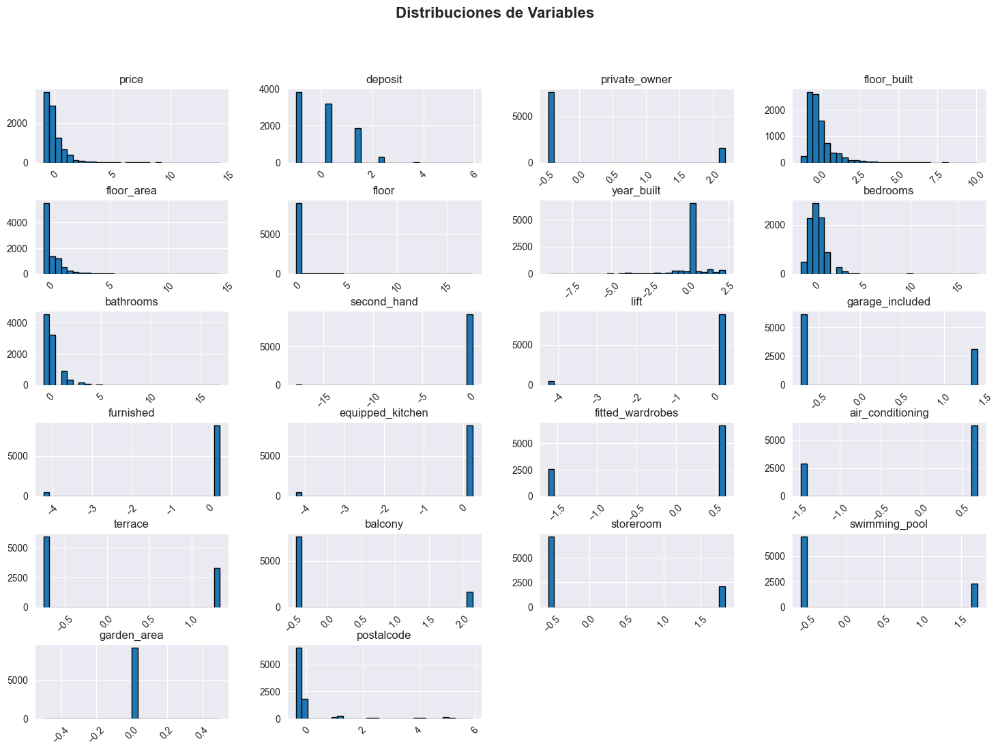

In [22]:
#DESCRIPCIÓN 
print(proyecto.describe())

# Calcular filas y columnas dinámicamente
num_vars = len(num_cols)
ncols = 4  # Número deseado de columnas
nrows = int(np.ceil(num_vars / ncols))  # Calcular número de filas

# Crear figura y subgráficos ajustados
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(18, 12))
axes = axes.flatten()  # Convertimos la matriz de ejes en una lista

# Generar histogramas para cada variable numérica
for i, col in enumerate(num_cols):
    proyecto[col].hist(ax=axes[i], bins=30, edgecolor='black')
    axes[i].set_title(col, fontsize=12)
    axes[i].tick_params(axis='x', rotation=45, labelsize=10)
    axes[i].tick_params(axis='y', labelsize=10)

# Ocultar ejes vacíos en caso de que sobren espacios
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar separación entre gráficos
plt.subplots_adjust(hspace=0.5, wspace=0.3)
plt.suptitle("Distribuciones de Variables", fontsize=16, fontweight="bold")
plt.show()


- PRICE: Distribución sesgada a la derecha; mayoría de valores bajos con algunos precios muy altos.
- DEPOSIT: Concentración en pocos puntos, posiblemente valores categóricos.
- YEAR BUILT: Predominio de construcciones recientes, pocas propiedades antiguas.
- ROOMS: Valores concentrados en el rango bajo.
-BINARIAS(garage_included, furnished, air_conditioning...): Predominan los valores 0 y 1.
- POSTAL CODE (Código postal): Distribución dispersa, representando varias ubicaciones.

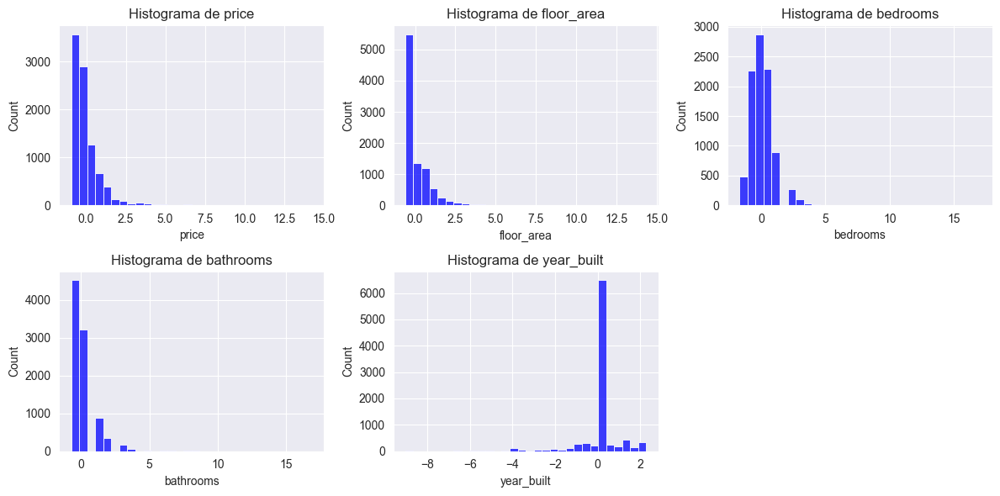

In [23]:
#HISTOGRAMAS COLUMNAS NUMERICAS; Mejorar la visión

numericas = ['price', 'floor_area', 'bedrooms', 'bathrooms', 'year_built']

# Generar histogramas
plt.figure(figsize=(12, 6))
for i, col in enumerate(numericas):
    plt.subplot(2, 3, i+1)
    sns.histplot(proyecto[col], bins=30, kde=False, color='blue')
    plt.title(f'Histograma de {col}')
plt.tight_layout()
plt.show()

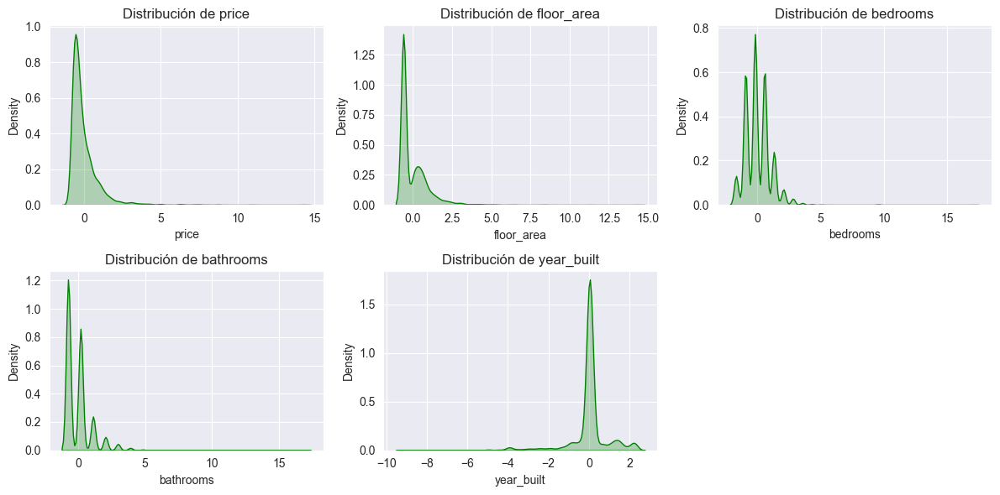

In [24]:
# GRÁFICOS DE DENSIDAD 
plt.figure(figsize=(12, 6))
for i, col in enumerate(numericas):
    plt.subplot(2, 3, i+1)
    sns.kdeplot(proyecto[col], fill=True, color='green')
    plt.title(f'Distribución de {col}')
plt.tight_layout()
plt.show()

In [25]:
# SKEWNESS y KURTOSIS
skewness = proyecto[numericas].apply(lambda x: skew(x.dropna(), nan_policy='omit'))
kurt = proyecto[numericas].apply(lambda x: kurtosis(x.dropna(), nan_policy='omit'))

skew_kurt_df = pd.DataFrame({'Skewness': skewness, 'Kurtosis': kurt})
print(skew_kurt_df)  # Mostrar tabla de asimetría y curtosis
plt.tight_layout()
plt.show()

            Skewness   Kurtosis
price       4.119174  29.012979
floor_area  3.633861  26.739627
bedrooms    1.702316  15.047307
bathrooms   2.801583  19.141643
year_built -1.989334  10.388343


<Figure size 640x480 with 0 Axes>

2.1.2 ELIMINACIÓN DE OUTLIERS
##Se han detectado outliers, por lo que voy a proceder a su transformación 


In [26]:
# Aplicar log-transform 
proyecto['price_log'] = np.log1p(proyecto['price'])
proyecto['floor_area_log'] = np.log1p(proyecto['floor_area'])
proyecto['bathrooms_log'] = np.log1p(proyecto['bathrooms'])

# Aplicar transformación inversa a year_built 
proyecto['year_built_inv'] = 1 / (proyecto['year_built'] + 1)

# Aplicar winsorization 
from scipy.stats.mstats import winsorize

proyecto['price_wins'] = winsorize(proyecto['price'], limits=[0.01, 0.01])
proyecto['floor_area_wins'] = winsorize(proyecto['floor_area'], limits=[0.01, 0.01])
proyecto['bathrooms_wins'] = winsorize(proyecto['bathrooms'], limits=[0.01, 0.01])
proyecto['bedrooms_wins'] = winsorize(proyecto['bedrooms'], limits=[0.01, 0.01])

# Confirmar los cambios con nuevas métricas de asimetría y curtosis
skewness = proyecto[['price_log', 'floor_area_log', 'bathrooms_log', 'year_built_inv']].apply(lambda x: skew(x, nan_policy='omit'))
kurtosis_vals = proyecto[['price_log', 'floor_area_log', 'bathrooms_log', 'year_built_inv']].apply(lambda x: kurtosis(x, nan_policy='omit'))

skew_kurt_df = pd.DataFrame({'Skewness': skewness, 'Kurtosis': kurtosis_vals})
print(skew_kurt_df)

                Skewness    Kurtosis
price_log       0.439753    0.052671
floor_area_log  0.772364   -0.659372
bathrooms_log   0.308081   -1.341033
year_built_inv  7.321402  166.970622


Alta asimetría positiva en price, floor_area y bathrooms .
Alta curtosis en varias variables, valores atípicos.
Sesgo negativo en year_built, sugiriendo que la mayoría de las propiedades son recientes.

In [27]:
# Eliminación de valores negativos
proyecto = proyecto[(proyecto["price"] > 0) & (proyecto["floor_area"] > 0)]


2.2 EDA BIVARIANTE

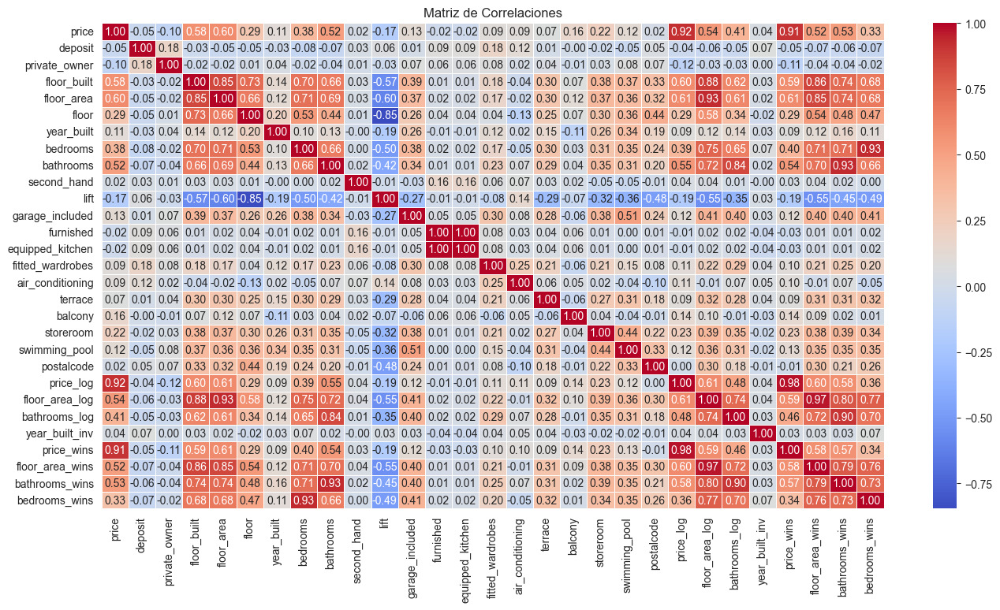

In [28]:
# MATRIZ DE CORRELACIONES 
num_proyecto = proyecto.select_dtypes(include=['int64', 'float64']).drop(columns=['garden_area'], errors='ignore')
plt.figure(figsize=(16, 8))
sns.heatmap(num_proyecto.corr(), annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Matriz de Correlaciones")
plt.show()

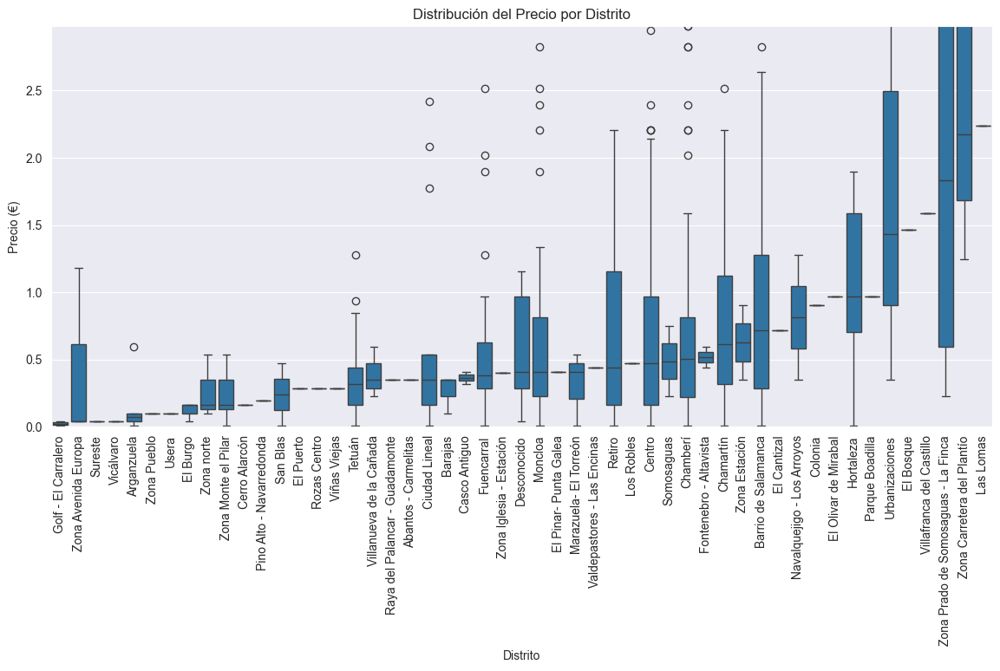

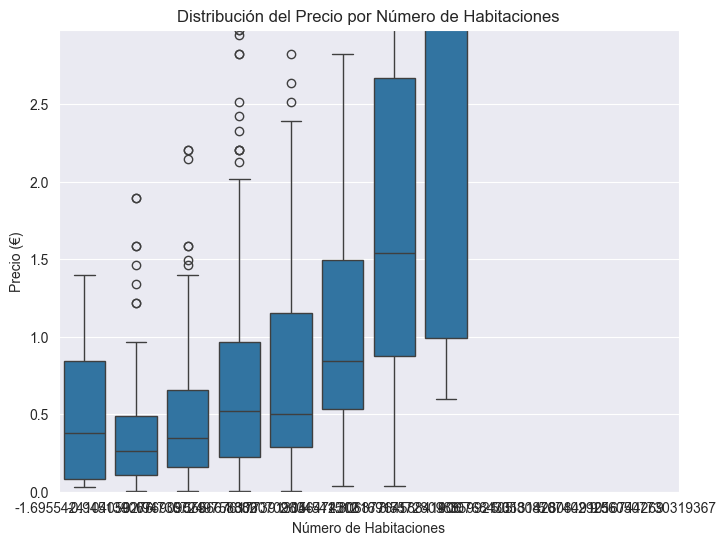

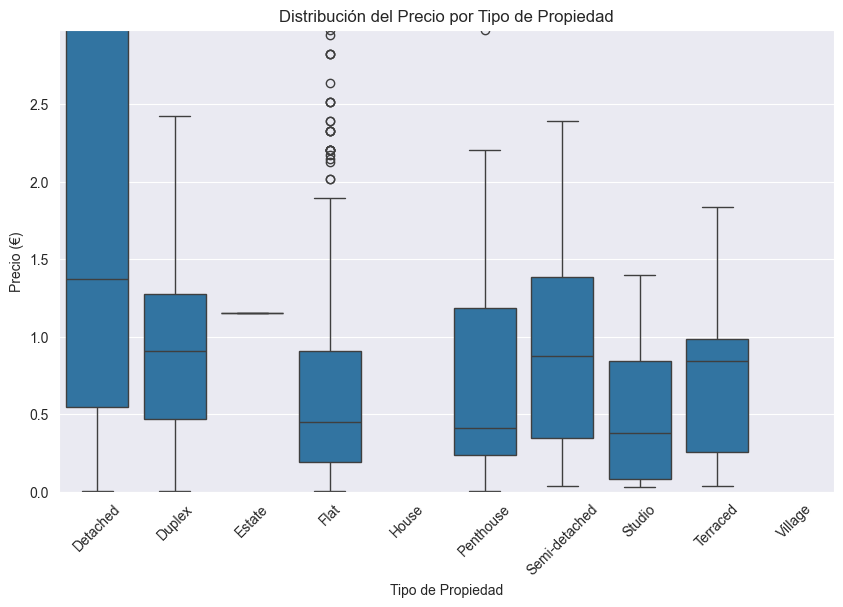

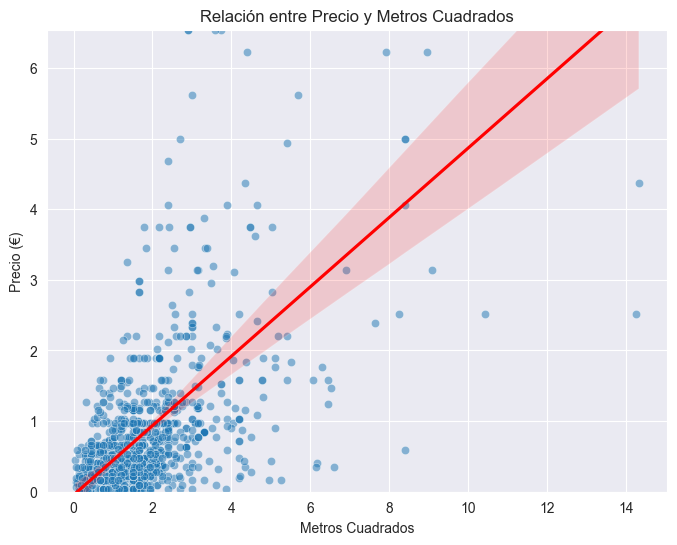

In [29]:
# BOXPLOT: Distribución del Precio por Distrito (ordenado por mediana del precio)
plt.figure(figsize=(14, 6))
order = proyecto.groupby("district")["price"].median().sort_values().index  # Ordenar por mediana
sns.boxplot(data=proyecto, x='district', y='price', order=order)
plt.title("Distribución del Precio por Distrito")
plt.xlabel("Distrito")
plt.ylabel("Precio (€)")
plt.xticks(rotation=90)
plt.ylim(0, proyecto["price"].quantile(0.95))  # Limitar para evitar outliers extremos
plt.show()

# BOXPLOT del Precio por Número de Habitaciones
plt.figure(figsize=(8, 6))
sns.boxplot(data=proyecto, x='bedrooms', y='price')
plt.title("Distribución del Precio por Número de Habitaciones")
plt.xlabel("Número de Habitaciones")
plt.ylabel("Precio (€)")
plt.ylim(0, proyecto["price"].quantile(0.95))
plt.show()

#BOXPLOT por TIPO DE PROPIEDAD
plt.figure(figsize=(10, 6))
sns.boxplot(data=proyecto, x='type', y='price')
plt.title("Distribución del Precio por Tipo de Propiedad")
plt.xlabel("Tipo de Propiedad")
plt.ylabel("Precio (€)")
plt.xticks(rotation=45)
plt.ylim(0, proyecto["price"].quantile(0.95))
plt.show()


# SCATTERPLOT entre Precio y Metros Cuadrados con Regresión
plt.figure(figsize=(8, 6))
sns.scatterplot(data=proyecto, x='floor_area', y='price', alpha=0.5)
sns.regplot(data=proyecto, x='floor_area', y='price', scatter=False, color='red')
plt.title("Relación entre Precio y Metros Cuadrados")
plt.xlabel("Metros Cuadrados")
plt.ylabel("Precio (€)")
plt.ylim(0, proyecto["price"].quantile(0.99))  # Evitar distorsión por outliers
plt.show()

2.3 EDA MULTIVARIANTE

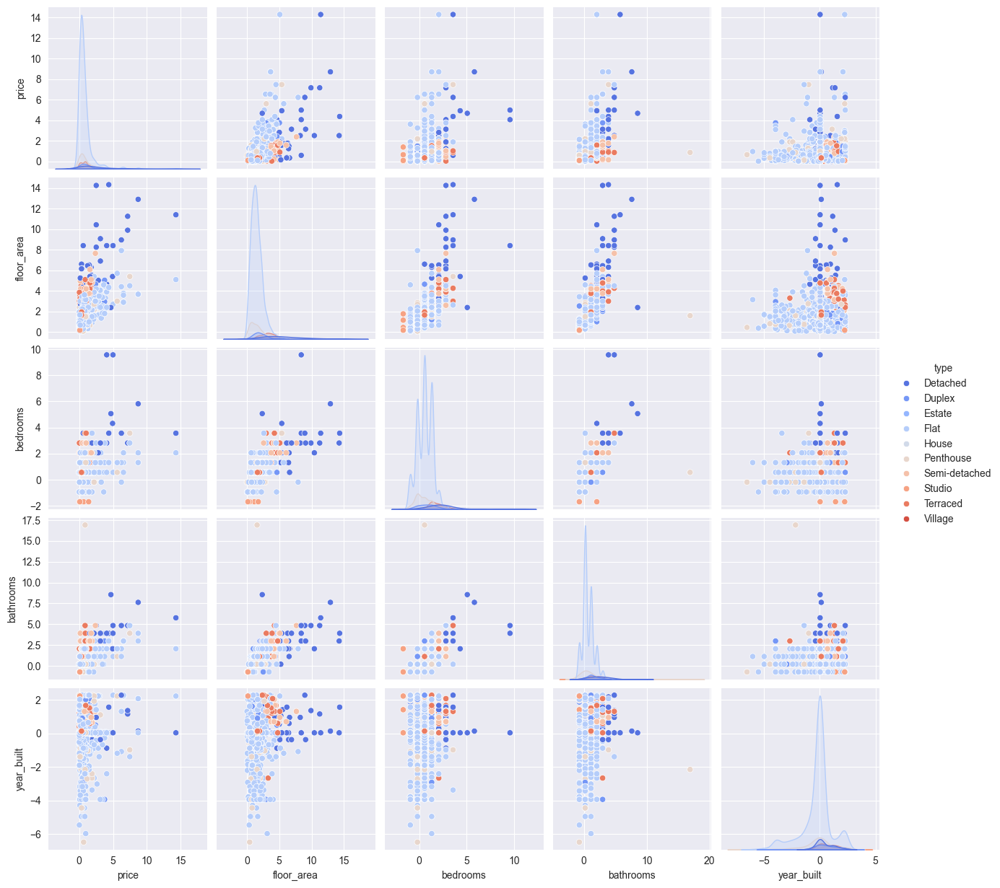

In [30]:
# Selección de variables clave
variables_interes = ["price", "floor_area", "bedrooms", "bathrooms", "year_built"]

# Pairplot con diferenciación por tipo de propiedad
sns.pairplot(proyecto[variables_interes + ["type"]], hue="type", diag_kind="kde", palette="coolwarm")
plt.show()


In [31]:
# Relación entre precio y tamaño
fig = px.scatter(proyecto, 
                 x="floor_area", 
                 y="price", 
                 color="type",  # Diferenciar por tipo de vivienda
                 size="price",  # Tamaño del punto según precio
                 hover_data=["district", "bedrooms", "bathrooms"],  # Información extra al pasar el mouse
                 title="Relación entre Área y Precio")

# Mostrar gráfico interactivo
fig.show()

In [32]:
# SCATTERPLOT INTERACTIVO
fig = px.box(proyecto, 
             x="district", 
             y="price", 
             color="district",  # Colorear por distrito
             title="Distribución del Precio por Distrito",
             hover_data=["bedrooms", "bathrooms", "floor_area"])  # Información extra al pasar el mouse

# Mejorar visualización
fig.update_layout(xaxis_tickangle=-45)  # Rotar etiquetas para mejor lectura

# Mostrar gráfico interactivo
fig.show()

In [33]:
#PLOTLY Relación de precio, habitaciones, baños y metros
fig = px.scatter_matrix(proyecto, 
                         dimensions=["price", "floor_area", "bedrooms", "bathrooms"], 
                         color="type",
                         title="Matriz de Dispersión Interactiva")
fig.show()


3. PREPROCESADO

#PREPROCESADO
-Codificación de variables categóricas (OneHotEncoder o LabelEncoder).
-Imputación de valores nulos (SimpleImputer, KNNImputer, etc.).
-Manejo de outliers (winsorization, transformación logarítmica, eliminación).
-Separar en train y test para evaluar modelos.
-Métodos como PCA, selección por correlación o importancia de variables.

In [34]:
proyecto.head() # Lo hice para ver como estaba la situacion

,title,type,price,deposit,private_owner,professional_name,floor_built,floor_area,floor,year_built,...,subdistrict,postalcode,price_log,floor_area_log,bathrooms_log,year_built_inv,price_wins,floor_area_wins,bathrooms_wins,bedrooms_wins
8,Terraced house for rent in calle de la Madre ...,Terraced,1.211785,-0.993882,-0.459170,Ivory Homes,0.352316,1.496774,2.724594,0.040145,...,Nueva España,-0.277984,0.793800,0.914999,1.116509,0.961405,1.211785,1.496774,2.054173,1.306071
22,Duplex for rent in Bernabéu-Hispanoamérica,Duplex,0.967200,0.159606,-0.459170,Inmobiliaria Internacional CPM,1.625556,2.547269,4.988273,-0.470390,...,Bernabéu-Hispanoamérica,-0.145665,0.676611,1.266178,0.754113,1.888182,0.967200,2.547269,1.125726,0.555668
42,Flat / apartment for rent in calle de Juan Ram...,Flat,0.038393,-0.993882,2.177843,nan,-0.519452,0.221173,-0.150891,0.040145,...,Bernabéu-Hispanoamérica,-0.145665,0.037675,0.199812,-1.313670,0.961405,0.038393,0.221173,-0.731168,-0.945139
43,Flat / apartment for rent in calle de Juan Ram...,Flat,0.038393,-0.993882,2.177843,nan,-0.347393,0.446279,-0.150891,0.040145,...,Bernabéu-Hispanoamérica,-0.145665,0.037675,0.368994,-1.313670,0.961405,0.038393,0.446279,-0.731168,-0.945139
47,Flat / apartment for rent in Av. de Pío XII,Flat,0.391340,0.159606,-0.459170,BLUEGROUND ESPAÑA S.L.U.,-0.462099,0.431272,-0.150891,0.091198,...,Nueva España,-0.357376,0.330267,0.358563,0.180051,0.916424,0.391340,0.431272,0.197279,-0.194736


In [35]:
proyecto.dtypes

title                category
type                 category
price                 float64
deposit               float64
private_owner         float64
professional_name      object
floor_built           float64
floor_area            float64
floor                 float64
year_built            float64
orientation          category
bedrooms              float64
bathrooms             float64
second_hand           float64
lift                  float64
garage_included       float64
furnished             float64
equipped_kitchen      float64
fitted_wardrobes      float64
air_conditioning      float64
terrace               float64
balcony               float64
storeroom             float64
swimming_pool         float64
garden_area           float64
location             category
district               object
subdistrict            object
postalcode            float64
price_log             float64
floor_area_log        float64
bathrooms_log         float64
year_built_inv        float64
price_wins

In [36]:
proyecto.drop(columns=['title', 'professional_name'], inplace=True)

In [37]:
categorical_columns = proyecto.select_dtypes(include=["object", "category"]).columns.tolist()
numerical_columns = proyecto.select_dtypes(include=["int64", "float64"]).columns.tolist()
# Aplicar One-Hot Encoding
# proyecto = pd.get_dummies(proyecto, columns=categorical_columns, drop_first=True, dtype=int)
# # Aplicar Label Encoding
# Aplicar Label Encoding a cada columna categórica
label_encoders = {}  # Para guardar los encoders y poder revertir la transformación si es necesario

for col in categorical_columns:
    encoder = LabelEncoder()
    proyecto[col] = encoder.fit_transform(proyecto[col])  # Transformar la columna
    proyecto[col] = proyecto[col].astype('int64')  # Convertir a int64
    label_encoders[col] = encoder  # Guardar el encoder por si lo necesitas después

In [38]:
# Opción 2: Imputación con KNN
knn_imputer = KNNImputer(n_neighbors=5)
proyecto[numerical_columns] = knn_imputer.fit_transform(proyecto[numerical_columns])


In [39]:
from sklearn.decomposition import PCA

# 4️⃣ Manejo de Outliers con IQR
Q1 = proyecto[numerical_columns].quantile(0.25)
Q3 = proyecto[numerical_columns].quantile(0.75)
IQR = Q3 - Q1
proyecto = proyecto[~((proyecto[numerical_columns] < (Q1 - 1.5 * IQR)) | (proyecto[numerical_columns] > (Q3 + 1.5 * IQR))).any(axis=1)]


# 6️⃣ PCA para reducción de dimensionalidad
pca = PCA(n_components=5)  # Número de componentes a mantener
proyecto_pca = pca.fit_transform(proyecto[numerical_columns])
explained_variance = pca.explained_variance_ratio_


# 7️⃣ Separar en Train/Test
X = proyecto.drop(columns=['price'])  # Variable objetivo: 'price'
y = proyecto['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("Preprocesado completado. Datos listos para modelado.")

Preprocesado completado. Datos listos para modelado.


In [40]:
proyecto.head(10)  # Para que veas como se queda

,type,price,deposit,private_owner,floor_built,floor_area,floor,year_built,orientation,bedrooms,...,subdistrict,postalcode,price_log,floor_area_log,bathrooms_log,year_built_inv,price_wins,floor_area_wins,bathrooms_wins,bedrooms_wins
86,3,0.347995,0.159606,-0.45917,1.258495,2.172092,-0.150891,0.550679,4,2.056474,...,14,-0.357376,0.298619,1.154391,0.754113,0.644879,0.347995,2.172092,1.125726,2.056474
97,3,0.347995,0.159606,-0.45917,0.226139,1.076576,-0.150891,0.040145,4,-0.194736,...,33,-0.344144,0.298619,0.730720,0.180051,0.961405,0.347995,1.076576,0.197279,-0.194736
110,3,1.183921,1.313095,-0.45917,2.004086,3.147552,-0.150891,0.040145,3,1.306071,...,33,-0.357376,0.781122,1.422518,1.116509,0.961405,1.183921,3.147552,2.054173,1.306071
122,3,0.409916,0.159606,-0.45917,0.317904,1.346703,-0.150891,-0.266176,0,0.555668,...,58,-0.357376,0.343530,0.853011,0.180051,1.362725,0.409916,1.346703,0.197279,0.555668
150,3,0.193194,0.159606,-0.45917,-0.175333,0.626364,-0.150891,-0.113016,3,0.555668,...,58,-0.357376,0.176634,0.486347,0.754113,1.127416,0.193194,0.626364,1.125726,0.555668
153,3,0.626637,-0.993882,-0.45917,0.788200,1.646845,-0.150891,-0.419337,4,0.555668,...,58,-0.277984,0.486515,0.973368,0.754113,1.722168,0.626637,1.646845,1.125726,0.555668
174,3,0.843359,1.313095,-0.45917,0.925847,1.631838,-0.150891,-0.266176,0,1.306071,...,58,-0.357376,0.611589,0.967682,0.754113,1.362725,0.843359,1.631838,1.125726,1.306071
179,3,0.440876,-0.993882,-0.45917,0.581728,1.796915,-0.150891,0.040145,0,0.555668,...,58,-0.357376,0.365251,1.028517,0.180051,0.961405,0.440876,1.796915,0.197279,0.555668
197,3,0.007433,-0.993882,-0.45917,0.054079,1.046562,-0.150891,0.040145,0,-0.194736,...,10,-0.145665,0.007406,0.716161,0.180051,0.961405,0.007433,1.046562,0.197279,-0.194736
212,3,0.812399,0.159606,-0.45917,1.373202,2.097057,-0.150891,0.040145,4,0.555668,...,33,-0.357376,0.594651,1.130452,0.180051,0.961405,0.812399,2.097057,0.197279,0.555668


In [41]:
proyecto.dtypes

type                  int64
price               float64
deposit             float64
private_owner       float64
floor_built         float64
floor_area          float64
floor               float64
year_built          float64
orientation           int64
bedrooms            float64
bathrooms           float64
second_hand         float64
lift                float64
garage_included     float64
furnished           float64
equipped_kitchen    float64
fitted_wardrobes    float64
air_conditioning    float64
terrace             float64
balcony             float64
storeroom           float64
swimming_pool       float64
garden_area         float64
location              int64
district              int64
subdistrict           int64
postalcode          float64
price_log           float64
floor_area_log      float64
bathrooms_log       float64
year_built_inv      float64
price_wins          float64
floor_area_wins     float64
bathrooms_wins      float64
bedrooms_wins       float64
dtype: object

In [45]:
# Ejemplo de modelos para ver que va bien
# 🔹 Crear y entrenar el modelo de Regresión Lineal

from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
model = GradientBoostingRegressor()
model.fit(X_train, y_train)

# 🔹 Hacer predicciones
y_pred = model.predict(X_test)

# 🔹 Evaluar el modelo
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# 🔹 Mostrar resultados
print(f"MAE: {mae:.4f}")
print(f"MSE: {mse:.4f}")
print(f"R²: {r2:.4f}")

MAE: 0.0022
MSE: 0.0001
R²: 0.9998
